## 4. 이미지 프로세싱
### 4.1 ROI (Region of Interest) : 관심영역
- 연산 속도를 향상
- numpy slicing으로 대상 특성화
    - img[y:y+h, x:x+w] :  영역 픽셀 접근은 slicing이 효과적
```
import cv2
import numpy as np

img = cv2.imread('./img/sunset.jpg)
x = 320
y = 150
w = 50
h = 50

roi = img[y:y+h, x:x+w]
print(roi.shape)
cv2.imshow('img', img)

key = cv2.waitKey(0)
print(key)
cv2.destroyAllWindows()
```

In [10]:
import cv2
import numpy as np

img = cv2.imread('../data/opencv_img/sunset.jpg')
x = 320
y = 150
w = 50
h = 50

roi = img[y:y+h, x:x+w]
print(roi.shape)
cv2.rectangle(roi, (0,0), (h-1, w-1), (0,255,0))
cv2.imshow('img', img)

key = cv2.waitKey(0)
print(key)
cv2.destroyAllWindows()
cv2.waitKey(1)

(50, 50, 3)
51


-1

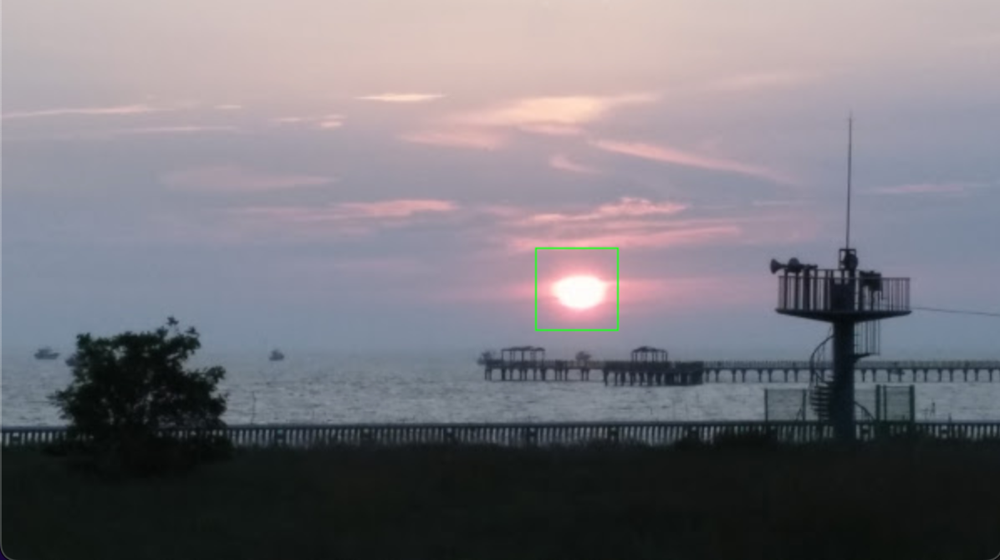

#### ROI 복제 및 새창 띄우기

In [22]:
import cv2
import numpy as np

img = cv2.imread('../data/opencv_img/sunset.jpg')
x = 320; y = 150; w = 50 ; h = 50 # roi

roi = img[y:y+h, x:x+w]
img2 = roi.copy()

img[y:y+h, x+w:x+w+w] = roi
cv2.rectangle(img, (x,y), (x+w+w, y+h), (0,255,0))

cv2.imshow('img', img)
cv2.imshow('roi', img2)

key = cv2.waitKey(0)
print(key)
cv2.destroyAllWindows()
cv2.waitKey(1)

49


-1

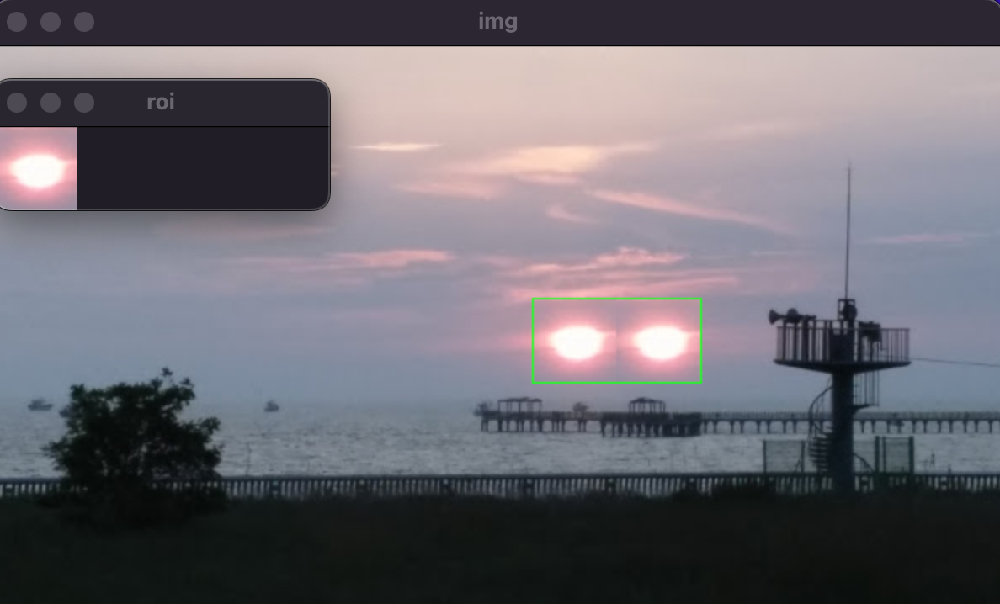

#### 마우스로 ROI 지정

In [21]:
import cv2
import numpy as np

isDragging = False                  # 마우스 드래그 상태 저장
x0, y0, w, h = -1, -1, -1, -1       # 영역선택 좌표 지정
blue, red = (255,0,0), (0,0,255)    # 색생 값

def onMouse(event, x, y, flags, param):     # 마우스 이벤트 핸들 함수
    global isDragging, x0, y0, img       # 전역 변수
    if event == cv2.EVENT_LBUTTONDOWN:
        isDragging = True
        x0 = x
        y0 = y
    elif event == cv2.EVENT_LBUTTONUP:
        if isDragging:
            isDragging = False
            w = x - x0
            h = y - y0
            print('x : %d, y : %d, w : %d, h : %d' % (x0, y0, w, h))
            if w > 0 and h > 0:
                img_draw = img.copy()
            # 선택영역에 빨간색 사각형 표시
            cv2.rectangle(img_draw, (x0,y0), (x,y), red, 2)
            cv2.imshow('img', img_draw)
            roi = img[y0:y0+h, x0:x0+w]
            cv2.imshow('cropped', roi)
            cv2.moveWindow('cropped', 0, 0)
            cv2.imwrite('../data/opencv_img/result/cropped.jpg', roi)
            print('cropped.')
        else:
            # 드래그 방향이 잘못된 경우 사각형 그림이 없는 원본 이미지 출력
            cv2.imshow('img', img)
            print('좌측 상단에서 우측 하단으로 영역을 드래그 하시오')

img = cv2.imread('../data/opencv_img/sunset.jpg')
cv2.imshow('img', img)
cv2.setMouseCallback('img', onMouse) # 마우스 이벤트 등록
cv2.waitKey()
cv2.destroyAllWindows()
cv2.waitKey(1)

x : 307, y : 148, w : 105, h : 78
cropped.


-1

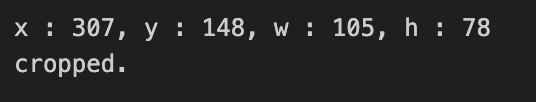
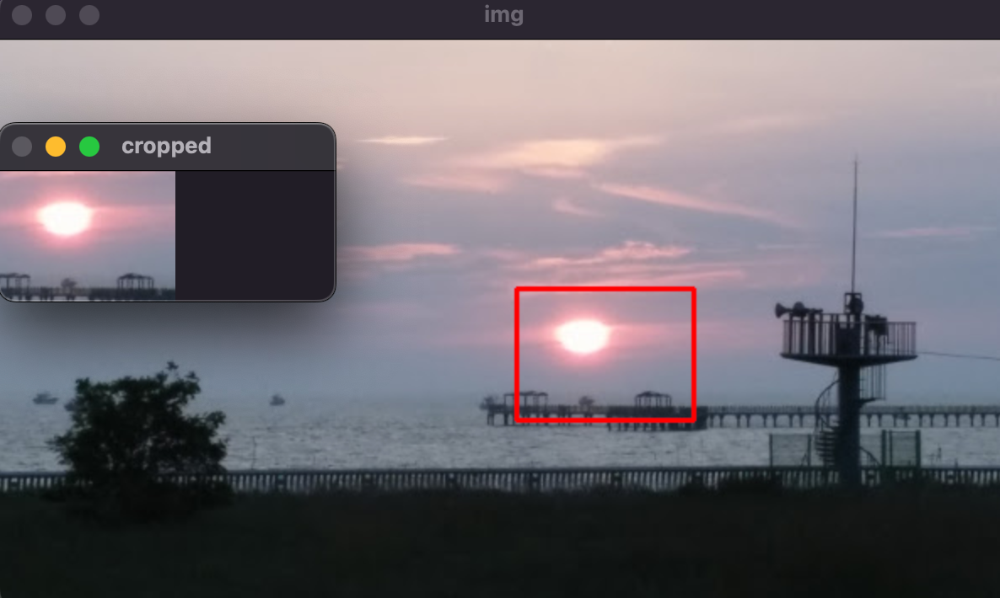

### ROI는 Face detector and recognizer에 쓰인다
#### Haar Cascade

> https://github.com/opencv/opencv/tree/4.x/data/haarcascades
>> Haar Cascade xml file들을 여기서 받을 수 있다

- 트리기반 객체 분류기
- 얼굴 인식에 효과적
- Haar-like feature
- 훈련 과정
    - 160,000+ 특징을 모든 훈련 이미지에 적용
    - 각 특징에 대해 최선의 Threshhold값 찾기
    - Adaboost : 오류율이 작은 특징만 선택; 요구하는 오류, 정확도, 특징 개수에 도달할 때까지 반복

```
classifier = cv2.CascadeClassifier('file.xml)
classifier.detectMultiScale(img, scaleFactor, minNeighbors[,flags, minSize, maxSize])
...
```
\# scaleFactor : 이미지 확대 크기에 제한; 1.3 ~ 1.5 <br>
\#   scale pyramid에 활용, 값이 크면 인식기회가 높아지고 속도 낮아짐

In [27]:
import cv2
import numpy as np

# 얼굴 검출을 위한 캐스케이드 분류기
face_cascade = cv2.CascadeClassifier('../data/opencv_data/haarcascade_frontalface_default.xml')
# 눈 검출을 위한 캐스케이드 분류기
eye_cascade = cv2.CascadeClassifier('../data/opencv_data/haarcascade_eye.xml')
# 검출할 이미지를 읽고 그레이 스케일로 변환
img = cv2.imread('../data/opencv_img/children.jpg')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

# 얼굴 검출
faces = face_cascade.detectMultiScale(gray)

# 검출된 얼굴 순회
for (x,y,w,h) in faces:
    # 검출된 얼굴에 사각형 표시
    cv2.rectangle(img, (x,y), (x+w, y+h), (255,0,0), 2)
    # 얼굴 영역을 ROI로 설정
    roi = gray[y:y+h, x:x+w]
    # ROI에서 눈 검출
    eyes = eye_cascade.detectMultiScale(roi)
    # 검출된 눈에 사각형 표
    for (ex,ey,ew,eh) in eyes:
        cv2.rectangle(img[y:y+h, x:x+w], (ex, ey), (ex+ew, ey+eh), (0,255,0), 2)
    
# 결과 출력
cv2.imshow('img', img)
cv2.waitKey(0)
cv2.destroyAllWindows()
cv2.waitKey(1)

-1

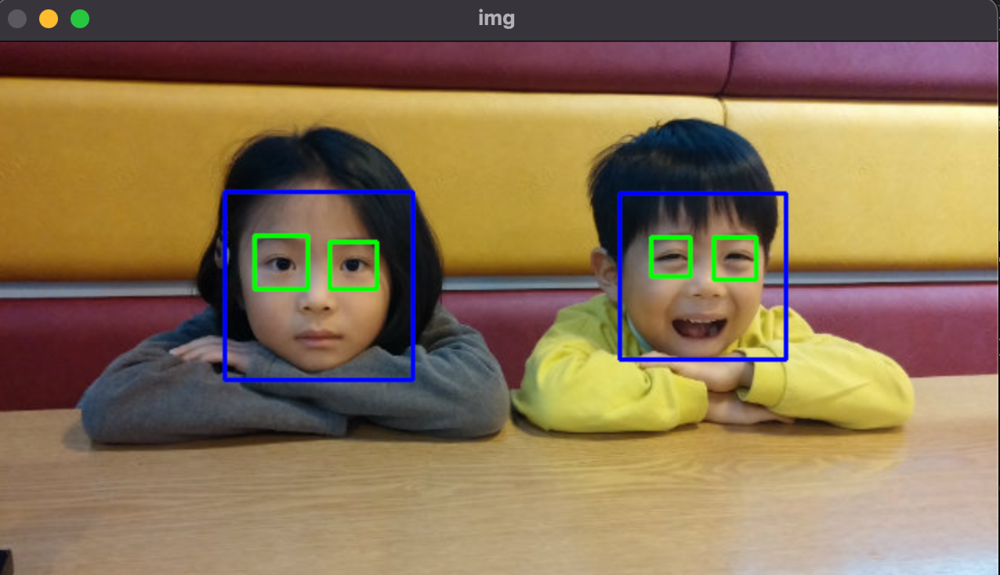

#### 카메라로 얼굴과 눈 검출

In [33]:
import cv2

# 얼굴과 눈 검출을 위한 캐스테이드 분류기 생성
face_cascade = cv2.CascadeClassifier('../data/opencv_data/haarcascade_frontalface_default.xml')
eye_cascade = cv2.CascadeClassifier('../data/opencv_data/haarcascade_eye.xml')

# 카메라 캡쳐 활성화
cap = cv2.VideoCapture(0)
while cap.isOpened():
    ret, img = cap.read()   # 프레임 읽기
    if ret:
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        # 얼굴 검출
        faces = face_cascade.detectMultiScale(gray, scaleFactor = 1.3, minNeighbors = 5, minSize = (80,80))
        for (x,y,w,h) in faces:
            cv2.rectangle(img, (x,y), (x+w, y+h), (0,255,0), 2)
            roi = gray[y:y+h, x:x+w]
            # 눈 검출
            eyes = eye_cascade.detectMultiScale(roi)
            for i, (ex, ey, ew, eh) in enumerate(eyes):
                if i >= 2:
                    break
                cv2.rectangle(img[y:y+h, x:x+w], (ex, ey), (ex+ew, ey+eh), (255,0,0), 2)
        cv2.imshow('face detect', img)
    else:
        break
    if 0xFF & cv2.waitKey(5) == 27:
        break
cv2.destroyAllWindows()
cv2.waitKey(1)

-1

<img src="/Users/heewonkim/Desktop/face_rec_cam.png" alt = "face_rec_cam.png" style="height: 100px; width:100px;"/>

### 4.2 Color Space
#### digital image
- Binary Image : 1px per 1 bit (white or black); 점의 밀도로 명암 표현
- Grayscale Image : 1px per 1byte = 8 bit; 255가지 명암 표현
- Color Image : 1px per 3 byte = 24 bit; 16,777,216색상 표현

#### RGB, BGR, RGBA
- RGB : 가장 널리 사용하는 coloe space
- row, column, channel
- 각 색상 값은 0 ~ 255

- BGR : openCV는 RGB값 반대로 사용


In [36]:
# BGR, BGRA, Alpha
import cv2
import numpy as np

img = cv2.imread('../data/opencv_img/opencv_logo.png')
bgr = cv2.imread('../data/opencv_img/opencv_logo.png', cv2.IMREAD_COLOR)        # 컬러 스케일, 기본값, 1, 투명영역 무시
bgra = cv2.imread('../data/opencv_img/opencv_logo.png', cv2.IMREAD_UNCHANGED)   # 파일에 저장된 스케일, -1, 투명영역까지 포함

print('default : ', img.shape, 'colour : ', bgr.shape, 'unchanged : ', bgra.shape)

cv2.imshow('bgr', bgr)
cv2.imshow('bgra', bgra)
cv2.imshow('alpha', bgra[:,:,3])        # 0:B, 1:G, 2:R, 3:channel

cv2.waitKey(0)
cv2.destroyAllWindows()
cv2.waitKey(1)

default :  (120, 98, 3) colour :  (120, 98, 3) unchanged :  (120, 98, 4)


-1

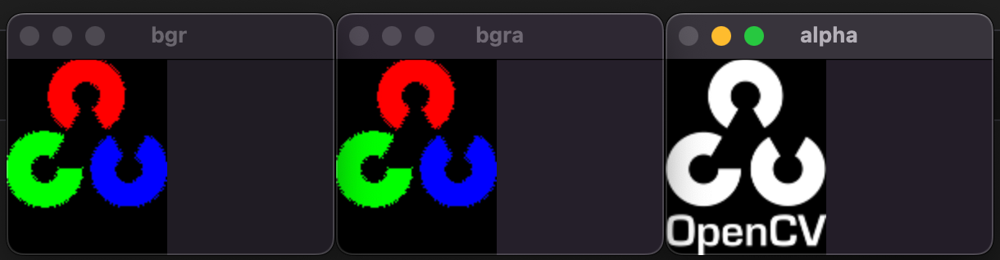

#### Colour 변환 함수
out = cv2.cvtColor(img, flag)img : Numpy array, 변환할 이미지
- flag : 변환할 컬러 스페이스, cv2.COLOR_로 시작, 274개
- out : numpy 배열

In [39]:
img = cv2.imread('../data/opencv_img/girl.jpg')
img2 = img.astype(np.uint16)

b,g,r = cv2.split(img2)
gray1 = ((b+g+r)/3).astype(np.uint8)            # 평균
gray2 = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)   # 함수

cv2.imshow('original', img)
cv2.imshow('gray1', gray1)
cv2.imshow('gray2', gray2)

cv2.waitKey(0)
cv2.destroyAllWindows()
cv2.waitKey(1)

-1

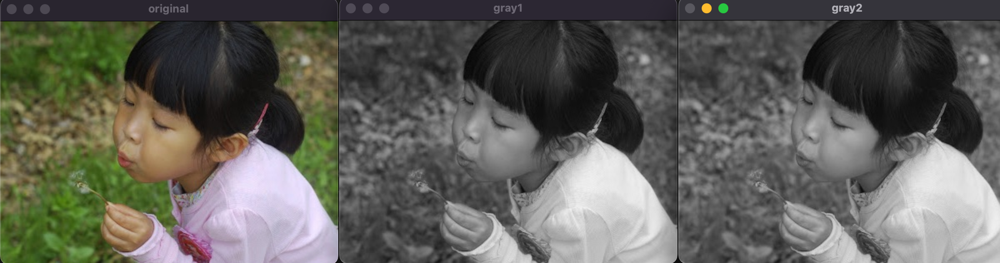

In [41]:
print("OpenCV version:")
print(cv2.__version__)

img = cv2.imread("../data/opencv_img/girl.jpg")
print("width: {} pixels".format(img.shape[1]))
print("height: {} pixels".format(img.shape[0]))
print("channels: {}".format(img.shape[2]))

(height, width) = img.shape[:2]
center = (width // 2, height // 2)

cv2.imshow("girl", img)
(Blue, Green, Red) = cv2.split(img)
cv2.imshow("Red Channel", Red)
cv2.imshow("Green Channel", Green)
cv2.imshow("Blue Channel", Blue)
cv2.waitKey(0)

zeros = np.zeros(img.shape[:2], dtype = "uint8")
cv2.imshow("Red", cv2.merge([zeros, zeros, Red]))
cv2.imshow("Green", cv2.merge([zeros, Green, zeros]))
cv2.imshow("Blue", cv2.merge([Blue, zeros, zeros]))
cv2.waitKey(0)

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
cv2.imshow("Gray Filter", gray)
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
cv2.imshow("HSV Filter", hsv)
# lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
yuv = cv2.cvtColor(img, cv2.COLOR_BGR2YUV)
cv2.imshow("YUV Filter", yuv)
cv2.waitKey(0)

BGR = cv2.merge([Blue, Green, Red])
cv2.imshow("Blue, Green and Red", BGR)
cv2.waitKey(0)

cv2.destroyAllWindows()
cv2.waitKey(1)

OpenCV version:
4.8.0
width: 406 pixels
height: 293 pixels
channels: 3


-1

: 

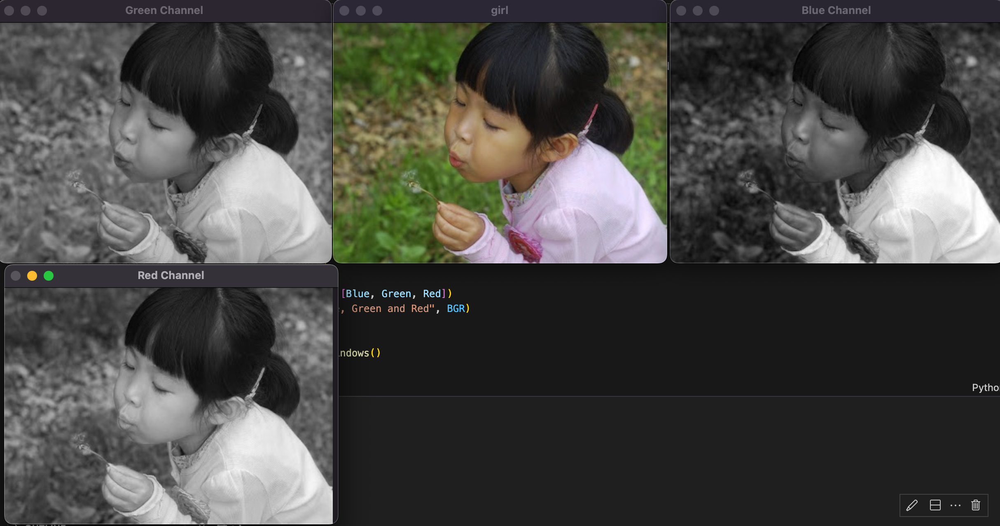

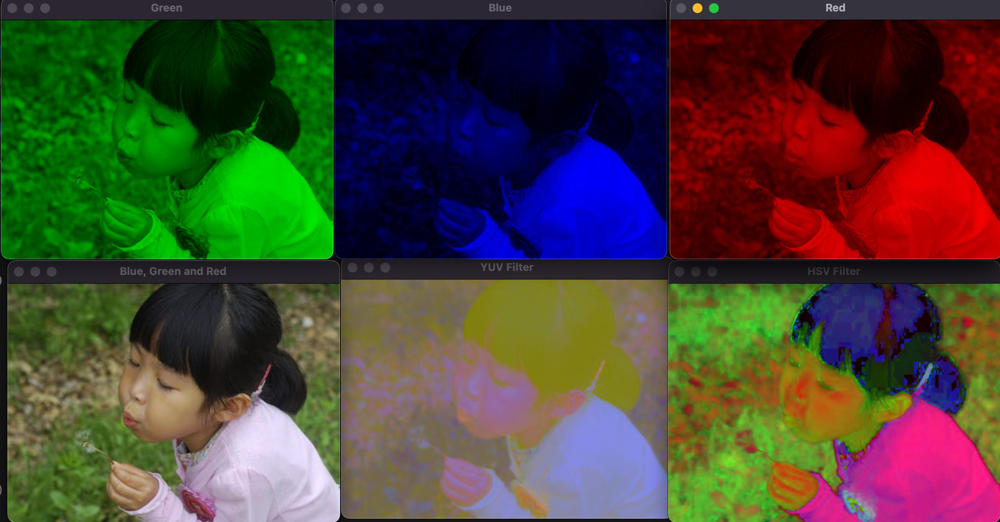

### 4.3 Threshold (임계값)
Binarisation 이진화
- two class classification 
    - 글씨와 종이, 배경과 전경
- global fixed thresholding 전역 고정 이진화

127.0


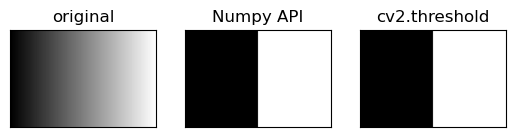

In [2]:
# simple global fixed thresholding
import numpy as np
import cv2
import matplotlib.pyplot as plt

img = cv2.imread('../data/opencv_img/gray_gradient.jpg', cv2.IMREAD_GRAYSCALE)

t_np = np.zeros_like(img)   # 원본과 동일한 크기의 0으로만 채워진 이미지
t_np[img > 127] = 255       # 127보다 큰 값만 255로 변경 

# 바이너리 이미지 만들기
ret, t_cv = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)
print(ret)      # == 127.0, 바이너리 이미지에 사용된 경계값 반환

# 원본과 결과물 출력
imgs = {'original' : img, 'Numpy API': t_np, 'cv2.threshold': t_cv}
for i, (key, value) in enumerate(imgs.items()):
    plt.subplot(1,3,i+1)
    plt.title(key)
    plt.imshow(value, cmap = 'gray')
    plt.xticks([]); plt.yticks([])
plt.show()

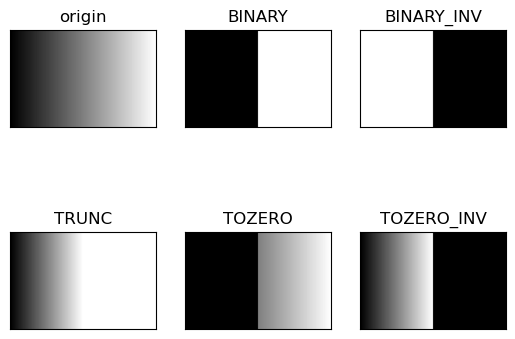

In [9]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread('../data/opencv_img/gray_gradient.jpg', cv2.IMREAD_GRAYSCALE)
_, t_bin = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY)
_, t_bininv = cv2.threshold(img, 127, 255, cv2.THRESH_BINARY_INV)
_, t_truc = cv2.threshold(img, 127, 255, cv2.THRESH_TRUNC)
_, t_2zr = cv2.threshold(img, 127, 255, cv2.THRESH_TOZERO)
_, t_2zrinv = cv2.threshold(img, 127, 255, cv2.THRESH_TOZERO_INV)

imgs = {'origin':img, 'BINARY':t_bin, 'BINARY_INV':t_bininv, 'TRUNC': t_truc, 
        'TOZERO': t_2zr, 'TOZERO_INV': t_2zrinv}
for i, (key, value) in enumerate(imgs.items()):
    plt.subplot(2,3,i+1)
    plt.title(key)
    plt.imshow (value, cmap= 'gray')
    plt.xticks([]); plt.yticks([])
plt.show()

#### 오츠 알고리즘
bimodal image에 사용하기 적합. 최적의 임계값을 자동으로 찾는다

otsu threshold :  131.0


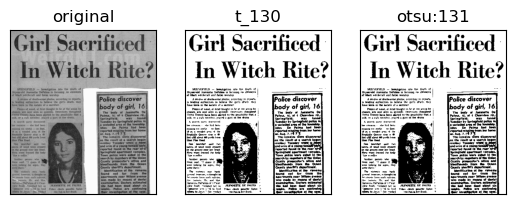

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# 이미지를 그레이 스케일로 읽기
img = cv2.imread('../data/opencv_img/scaned_paper.jpg', cv2.IMREAD_GRAYSCALE)

# 경계값 130으로 지정
_, t_130 = cv2.threshold(img, 130, 255, cv2.THRESH_BINARY)
# 경계값 지정하지 않고 오츠 알고리즘 선택
t, t_otsu = cv2.threshold(img, -1, 255, cv2.THRESH_BINARY|cv2.THRESH_OTSU)
print('otsu threshold : ', t)

imgs = {'original' : img, 't_130' : t_130, 'otsu:%d'%t : t_otsu}

for i, (key, value) in enumerate(imgs.items()):
    plt.subplot(1,3,i+1)
    plt.title(key)
    plt.imshow(value, cmap = 'gray')
    plt.xticks([]); plt.yticks([])
plt.show()

#### 적응형 스레시홀드 (Adaptive Threshold)
- sudoku scan example
- 이미지를 작은 영역으로 나누어 임계치를 적용
- blocksize : 홀수만 가능, 1보다는 큰값
- c : 일반적으로 양수의 값 사용

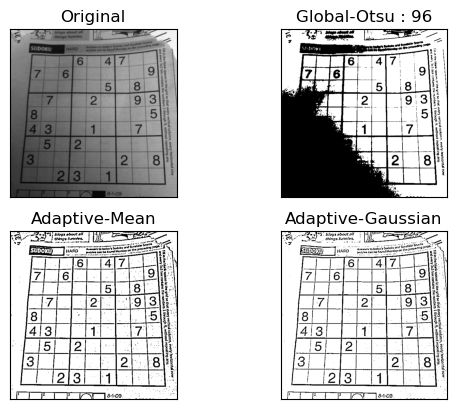

In [10]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

blk_size = 9    # 블럭 사이즈
C = 5           # 차감 상수
img = cv2.imread('../data/opencv_img/sudoku.png', cv2.IMREAD_GRAYSCALE)

# 오츠 알고리즘으로 단일 경계값을 전체 이미지에 적용
ret, th1 = cv2.threshold(img, 0,255, cv2.THRESH_BINARY|cv2.THRESH_OTSU)

# 적응형 스레스홀드를 평균과 가우시안 분포로 각각 적용
th2 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, blk_size, C)
th3 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, blk_size, C)

# 결과 출력
imgs = {'Original' : img, 'Global-Otsu : %d'%ret : th1, 'Adaptive-Mean' : th2, 'Adaptive-Gaussian' : th3}

for i, (k,v) in enumerate(imgs.items()):
    plt.subplot(2,2,i+1)
    plt.title(k)
    plt.imshow(v,'gray')
    plt.xticks([]); plt.yticks([])
plt.show()

- 경계값을 전체 이미지에 적용하는 것을 전역적(global)적용이라고 하는 반면, 이미지는 여러 구역으로 나누어 그 구역에 맞는 경계값을 찾는 것을 지역적(local) 적용이라고 합니다.
- ==> 대부분의 이미지는 조명 차이와 그림자 때문에 ***지역적 적용*** 이 필요

### 4.4 이미지 연산
- numpy broadcasting(+,-,*,/)
    - 0 < 연산 결과 < 255
- opencv 함수(src1, src2 [, dest, mask, dtype]) 
    - : src = 입력영상, dest = 출력영상, mask = 0이 아닌 픽셀만 연산, dtype = 출력 dtype
    - cv2.add, cv2.subtract, cv2.multiply, cv2.divide


In [11]:
import cv2
import numpy as np

# 연산에 사용할 배열 생성
a = np.uint8([[200, 50]])
b = np.uint8([[100, 100]])

# numpy배열 직접 연산
add1 = a + b
sub1 = a - b
mult1 = a * 2
div1 = a / 3

# opencv를 이용한 연산
add2 = cv2.add(a,b)
sub2 = cv2.subtract(a,b)
mult2 = cv2.multiply(a,2)
div2 = cv2.divide(a,3)

# 각 연산 결과 출력
print(add1, add2)
print(sub1, sub2)
print(mult1, mult2)
print(div1, div2)

[[ 44 150]] [[255 150]]
[[100 206]] [[100   0]]
[[144 100]] [[255 100]]
[[66.66666667 16.66666667]] [[67 17]]


In [13]:
import cv2
import numpy as np
# 연산에사용할 배열생성
a = np.array([[1, 2]], dtype = np.uint8)
b = np.array([[10, 20]], dtype = np.uint8) # 두번째요소가0인마스크배열생성
mask = np.array([[1,0]], dtype = np.uint8)
# 누적 할당과의 비교 연산
c1 = cv2.add(a, b, None, mask)
print(c1)
c2 = cv2.add(a, b, b, mask)
print(c2)

[[11  0]]
[[11 20]]


#### 이미지 단순 합성

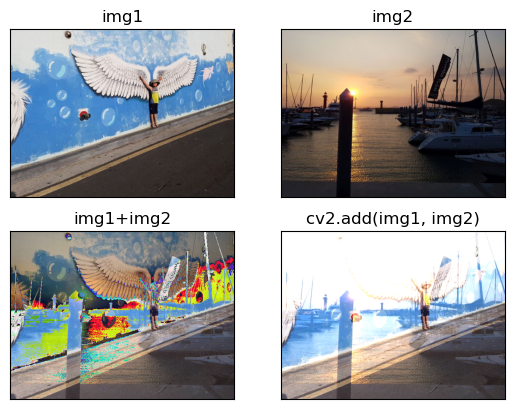

In [12]:
import cv2
import numpy as np
import matplotlib.pylab as plt

img1 = cv2.imread('../data/opencv_img/wing_wall.jpg')
img2 = cv2.imread('../data/opencv_img/yate.jpg')

img3 = img1 + img2          # 더하기 연산
img4 = cv2.add(img1, img2)  # opencv함수

imgs = {'img1':img1, 'img2': img2, 'img1+img2':img3, 'cv2.add(img1, img2)':img4}

for i, (k,v) in enumerate(imgs.items()):
    plt.subplot(2,2,i+1)
    plt.imshow(v[:,:,::-1])
    plt.title(k)
    plt.xticks([]); plt.yticks([])
plt.show()

- 직접 더하기 연산을 하면 255를 넘는 경우 초과값만 가지므로 영상이 거뭇거뭇하게 나타나고, cv2.add()를 사용할 경우 대부분의 픽셀 값니 255 가까이에 몰리는 현상이 일어나서 영상이 하얗게 날아간 것 처럼 보입니다.
- ==> 각 픽셀의 합이 255가 되지 않게 각각의 영상에 가중치를 줘서 계산해야 합니다!
    - ==> 가중치 알파(alpha) 값 사용해서 혼합 : 알파 블렌딩


#### blending alpha trackbar
: 2개 이미지 혼합
- 가중치 지정, alpha : beta, alpha + beta = 1
- a * alpha + b * beta <= 255
- cv2.addWeighted(img1, alpha, img2, beta, gamma)
    - : img = 이미지/영상, alpha = img1에 더할 가중치, beta = img2에 더할 가중치, gamma = 연산 결과에 가감할 상수, 흔히 0 적용

In [14]:
import cv2 
import numpy as np

alpha = 0.5     # 합성에 사용할 알파 값

# 합성에 사용할 사진 불러오기
img1 = cv2.imread('../data/opencv_img/wing_wall.jpg')
img2 = cv2.imread('../data/opencv_img/yate.jpg')

# 수식을 직접 연산해서 알파 블렌딩 적용
blended = img1 * alpha + img2 * (1-alpha)
blended = blended.astype(np.uint8)      # 소수점 발생 제거하기 위해
cv2.imshow('img1 * alpha + img2 * (1-alpha)', blended)

# addWeighted()함수 적용하여 알파 블렌딩 적용
dst = cv2.addWeighted(img1, alpha, img2, (1-alpha), 0)
cv2.imshow('cv2.addWeighted', dst)

cv2.waitKey(0)
cv2.destroyAllWindows()
cv2.waitKey(1)

-1

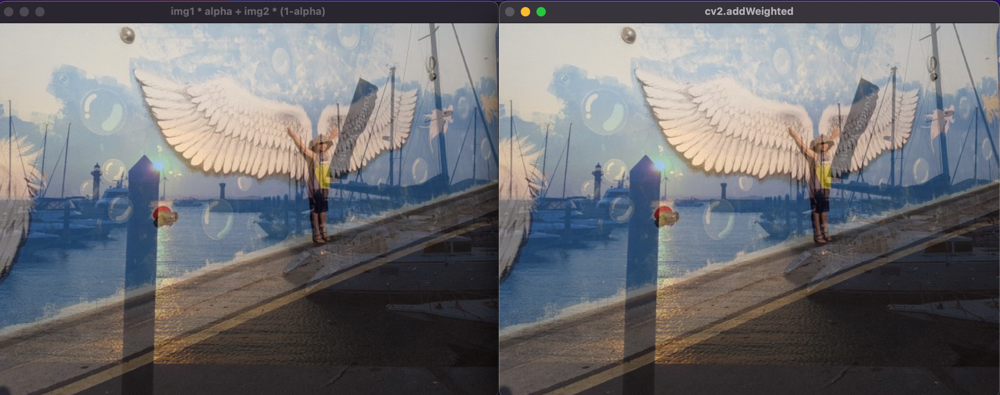

In [20]:
# 트랙바로 알파 블랜딩
import cv2
import numpy as np
win_name = 'Alpha blending' # 창 이름
trackbar_name = 'fade'      # 트랙바 이름

# 트랙바 이벤트 핸들러 함수
def onChange(x):
    alpha = x/100
    dst = cv2.addWeighted(img1, (1-alpha), img2, alpha, 0)
    cv2.imshow(win_name, dst)
   
# 사용할 사진 불러오기 
img1 = cv2.imread('../data/opencv_img/man_face.jpg')
img2 = cv2.imread('../data/opencv_img/lion_face.jpg')

# 이미지 표시 및 트랙바 붙이기
cv2.imshow(win_name, img1)
cv2.createTrackbar(trackbar_name, win_name, 0, 100, onChange)

cv2.waitKey(0)
cv2.destroyAllWindows()
cv2.waitKey(1)

-1

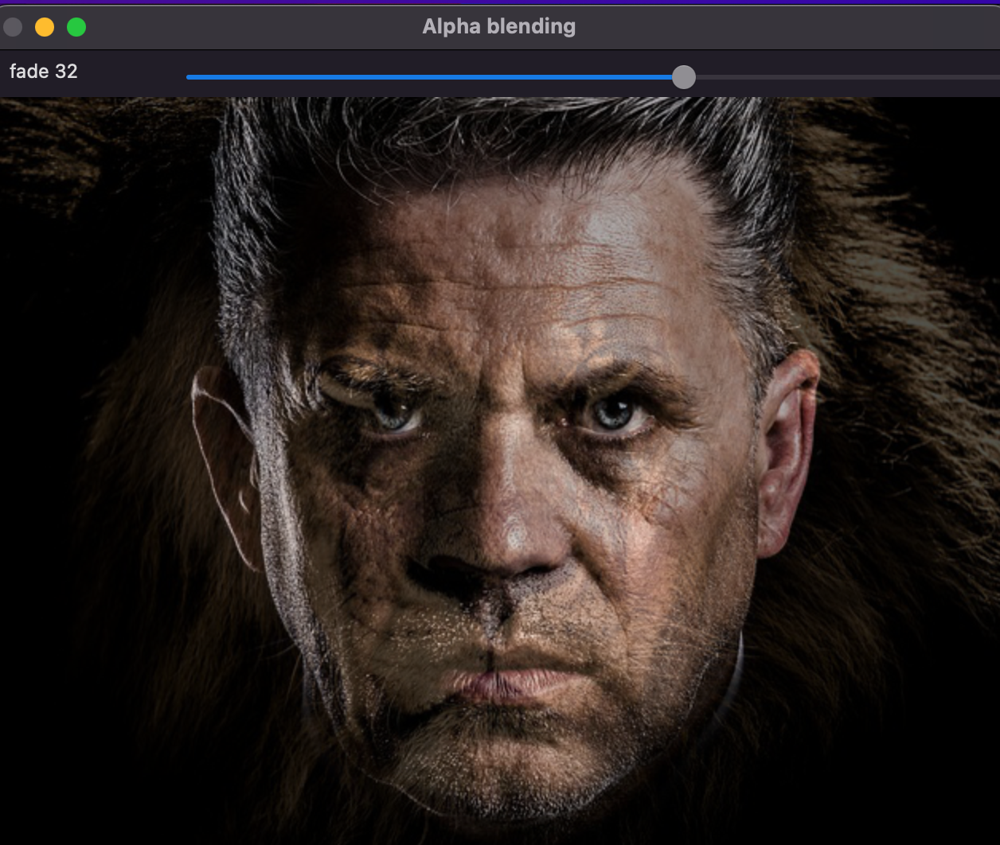

#### 비트와이즈 연산(bitwise)
- 특정영역만 선택하거나 특정영역만 제외하는 등의 선별적 연산에 도움이 된다.
- bitwise_add(img1, img2, mask = None), bitwise_or, birwise_xor
- bitwise_not(img1, mask=None)
    - img = 연산 대상 영상, 동일한 shape
    - mask = 0이 아닌 픽셀만 연산, 바이너리 이미지

In [22]:
import numpy as np
import cv2

img = cv2.imread('../data/opencv_img/girl.jpg')
mask = np.zeros_like(img)                               # 까만 스크린에
cv2.circle(mask, (150, 140), 100, (255,255,255), -1)    # 이 원을 뚫어주세요    
# cv2.circle(대상이미지, (원점x, 원점y), 반지름, (색상), 채우기)
# 마스킹
masked = cv2.bitwise_and(img, mask)

# 결과 출력
cv2.imshow('original', img)
cv2.imshow('mask', mask)
cv2.imshow('masked', masked)
cv2.waitKey(0)
cv2.destroyAllWindows()
cv2.waitKey(1)

-1

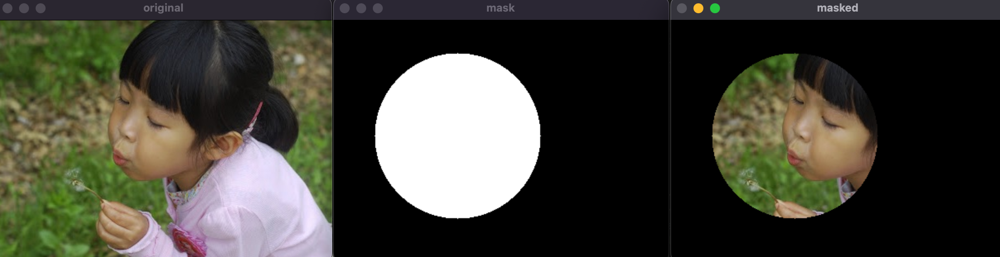

In [23]:
# 도면 차이 찾기
img1 = cv2.imread('../data/opencv_img/robot_arm1.jpg')
img2 = cv2.imread('../data/opencv_img/robot_arm2.jpg')
img1_gray = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
img2_gray = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)

# 두 영상의 절대값 차 연산
diff = cv2.absdiff(img1_gray, img2_gray)

# 차 영상을 극댜화하기 위해 스레시홀드 처리 및 컬러로 변환
_, diff = cv2.threshold(diff, 1, 255, cv2.THRESH_BINARY)
diff_red = cv2.cvtColor(diff, cv2.COLOR_GRAY2BGR)
diff_red[:,:,2] = 0

# 두번째 이미지에 변화 부분 표시
spot = cv2.bitwise_xor(img2, diff_red)

# 결과 영상 출력
cv2.imshow('img1', img1)
cv2.imshow('img2', img2)
cv2.imshow('diff', diff)
cv2.imshow('spot', spot)

cv2.waitKey(0)
cv2.destroyAllWindows()
cv2.waitKey(1)

-1

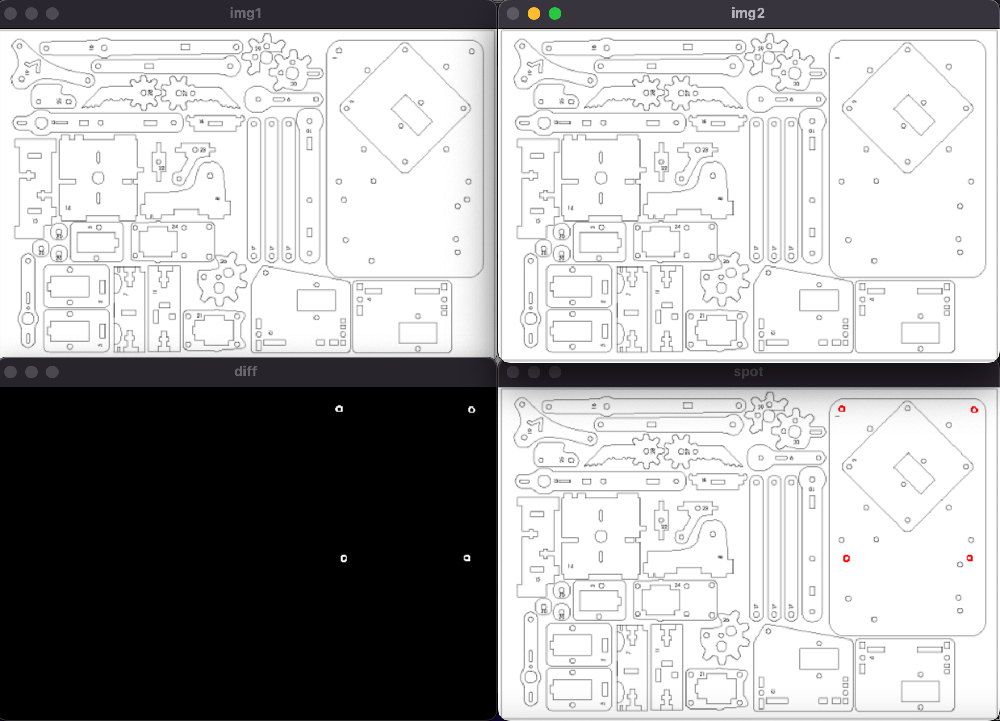

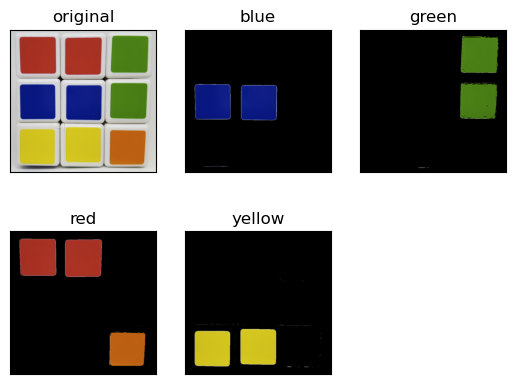

In [25]:
#arithmatic
import cv2
import numpy as np
import matplotlib.pylab as plt

#--① 큐브 영상 읽어서 HSV로 변환
img = cv2.imread("../data/opencv_img/cube.jpg")
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

#--② 색상별 영역 지정
blue1 = np.array([90, 50, 50])
blue2 = np.array([120, 255,255])
green1 = np.array([45, 50,50])
green2 = np.array([75, 255,255])
red1 = np.array([0, 50,50])
red2 = np.array([15, 255,255])
red3 = np.array([165, 50,50])
red4 = np.array([180, 255,255])
yellow1 = np.array([20, 50,50])
yellow2 = np.array([35, 255,255])

# --③ 색상에 따른 마스크 생성
mask_blue = cv2.inRange(hsv, blue1, blue2)
mask_green = cv2.inRange(hsv, green1, green2)
mask_red = cv2.inRange(hsv, red1, red2)
mask_red2 = cv2.inRange(hsv, red3, red4)
mask_yellow = cv2.inRange(hsv, yellow1, yellow2)

#--④ 색상별 마스크로 색상만 추출
res_blue = cv2.bitwise_and(img, img, mask=mask_blue)
res_green = cv2.bitwise_and(img, img, mask=mask_green)
res_red1 = cv2.bitwise_and(img, img, mask=mask_red)
res_red2 = cv2.bitwise_and(img, img, mask=mask_red2)
res_red = cv2.bitwise_or(res_red1, res_red2)
res_yellow = cv2.bitwise_and(img, img, mask=mask_yellow)

#--⑤ 결과 출력
imgs = {'original': img, 'blue':res_blue, 'green':res_green,
                            'red':res_red, 'yellow':res_yellow}
for i, (k, v) in enumerate(imgs.items()):
    plt.subplot(2,3, i+1)
    plt.title(k)
    plt.imshow(v[:,:,::-1])
    plt.xticks([]); plt.yticks([])
plt.show()


#### 크로마키 합성

In [31]:
import cv2
import numpy as np
import matplotlib.pylab as plt

# 크로마키 영상과 합성할 영상 읽기
img1 = cv2.imread('../data/opencv_img/man_chromakey.jpg')
img2 = cv2.imread('../data/opencv_img/street.jpg')

# ROI 선택을 위한 좌표 계산(가운데에 위치하기 위한)
height1, width1 = img1.shape[:2]
height2, width2 = img2.shape[:2]
x = (width2 - width1)//2
y = height2 - height1
w = x + width1
h = y + height1

# 크로마키 배경 영상에서 크로마키가 있을 법한 영역을 10픽셀 정도로 지정
chromakey = img1[:10, :10, :]
offset = 20
# 크로마키 영역과 영상 전체를 HSV로 변경
hsv_chroma = cv2.cvtColor(chromakey, cv2.COLOR_BGR2HSV)
hsv_img = cv2.cvtColor(img1, cv2.COLOR_BGR2HSV)

# 크로마키 영역의 H값에서 offset만큼 여유를 두어서 범위지정
# offset값은 여러 차례 시도 후 결정
chroma_h = hsv_chroma[:, :, 0]
lower = np.array([chroma_h.min() - offset, 100, 100])
upper = np.array([chroma_h.max() + offset, 255, 255])
# 마스크 생성 및 마스킹 후 합성
mask = cv2.inRange(hsv_img, lower, upper)
mask_inv = cv2.bitwise_not(mask)
roi = img2[y:h, x:w]
fg = cv2.bitwise_and(img1, img1, mask = mask_inv)
bg = cv2.bitwise_and(roi, roi, mask = mask)
img2[y:h,x:w] =fg+bg

# 결과 출력
cv2.imshow('chromakey', img1)
cv2.imshow('added', img2)
cv2.waitKey(0)
cv2.destroyAllWindows()
cv2.waitKey(1)

-1

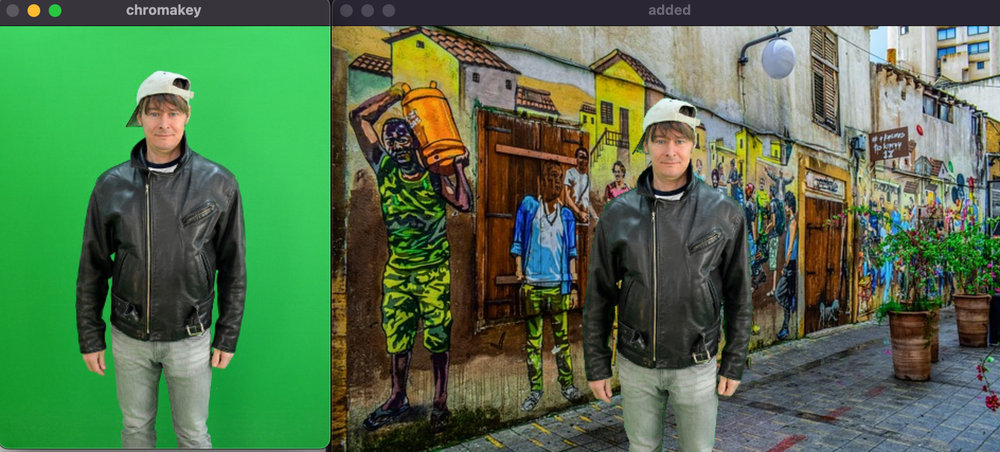